In [205]:
%load_ext autoreload
%autoreload 2
from aux_functions import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


<div class="alert-block alert-success alert">
    <p style="font-size:medium"><b>
    This notebook documents the experiments with topic modeling models for the DHQ article. For visualization, proposed longer pieces of code were moved to an auxiliary file <em>aux_functions.py</em>. Additionally, the specification of library versions is included in the <em>requirements.txt</em> file. This file can be used to install all external libraries required to run the code below.
    </p>
</div>

<div class="alert-block alert-success alert">
    <p style="font-size:medium">
    <b>Part 1:</b> Loading the data.
    </p>
</div>

In [5]:
file_ = codecs.open("data/full_text.tab","r","UTF-8")
data = pd.read_csv(file_, sep="\t")

data["length"] = data.full_text.apply(lambda row: len(row.split()))
data.head()

,id_document,source_file,full_text,length
0,164421,CU-Bahia.pdf,"11857- [Ant. 1765, Novembro, 9] REQUERIMENTO ...",52
1,281830,CU-RioJaneiro.pdf,17228- [post. 1808] REQUERIMENTO do soldado ...,79
2,195142,CU-Guine-Parcial.pdf,721 [ca. 1753] RELAÇÃO (traslado) das fazend...,38
3,188871,CU-CaboVerde-Parcial.pdf,"1549. 1744, Março, 30, Ribeira Grande CERTID...",60
4,168427,CU-Bahia.pdf,"15875- [post. 1803, Agosto, 18] REQUERIMENTO ...",52


<div class="alert alert-block alert-info">
    <p style="font-size:1em">
For the topic model, a critical feature is the length of the text. For example, the LDA model may give a bad quality for short text, and we need to try another approach. We can see that the average text size is as short as Tweets. A method created especially for short text, - GSDMM (Gibbs sampling algorithm for a Dirichlet Mixture Model), is recommended in this case. We will later check LDA-model results and compare with GSDMM result.
    </p>
</div>


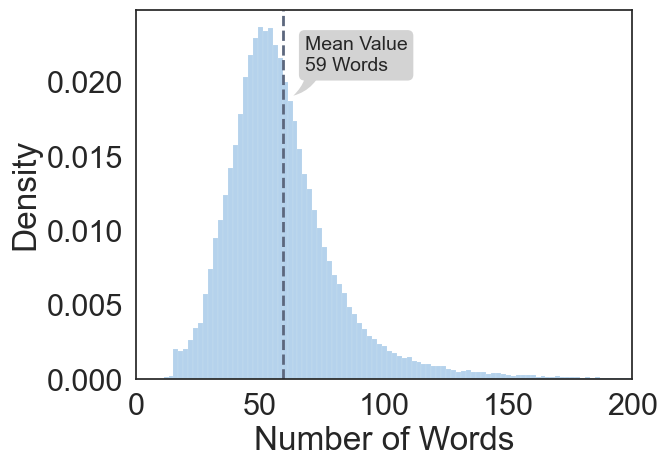

In [7]:
sns.set(font_scale=2)
sns.set_style('white')
mean_size = data["length"].mean()

ax = sns.histplot(data=data, x="length", stat='density', color="#9DC3E6", binwidth=2)
line = plt.axvline(x=mean_size,linestyle='dashed',lw=2,color='#5c677d',label='Mean')
ax.annotate(f'Mean Value\n{mean_size:0.0f} Words', size=14, xy=(mean_size*1.05, 0.019), xycoords='data', xytext=(10, 30), 
            textcoords='offset points', va="center", bbox=dict(boxstyle="round", fc="#d3d3d3", ec="none"),
            arrowprops=dict(arrowstyle="wedge,tail_width=1.", fc="#d3d3d3", ec="none", patchA=None,
                            connectionstyle="arc3,rad=-0.3", relpos=(0.1, 0.4)))
plt.xlim([0, 200])
plt.xlabel("Number of Words")
plt.show()

<div class="alert-block alert-success alert">
    <p style="font-size:medium">
    <b>Part 2:</b> Preparing the data.
    </p>
</div>

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    Before using the data as the input for the topic modelling methods, we must perform some preprocessing steps to remove unnecessary parts of the text. In this first step, we remove the parts of the document containing the date, document type and sender information.
    </p>
</div>

In [11]:
res = []
for index, row  in tqdm(data.iterrows(), leave=False):
    try:
        math = re.search(r"[A-ZÃÁÀÂÇÉÊÍÕÓÔÚÜ ]{4,}", row["full_text"])
        res.append(row["full_text"][math.end():])
    except:
        res.append(row["full_text"])
data["full_text"] = res
data.head()

,id_document,source_file,full_text,length
0,164421,CU-Bahia.pdf,"de Manuel de Sousa Baptista ao rei [D. José], ...",52
1,281830,CU-RioJaneiro.pdf,do soldado da Brigada Real da Marinha da 1ª Co...,79
2,195142,CU-Guine-Parcial.pdf,(traslado) das fazendas recebidas pelo capitão...,38
3,188871,CU-CaboVerde-Parcial.pdf,passada pelo escrivão da câmara da cidade da R...,60
4,168427,CU-Bahia.pdf,do cabo de esquadra do 1º Regimento de Linha d...,52


<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    Following, we employ regular expressions to remove special characters such as quotation marks, brackets, parenthesis and string of whitespace characters. All of these are irrelevant to the topic modelling methods.  
    </p>
</div>

In [13]:
data["full_text_list"] = pre_processing_regex(data.full_text)
data.head().full_text_list

0    de Manuel de Sousa Baptista ao rei [D. José], ...
1    do soldado da Brigada Real da Marinha da  Comp...
2    (traslado) das fazendas recebidas pelo capitão...
3    passada pelo escrivão da câmara da cidade da R...
4    do cabo de esquadra do  Regimento de Linha da ...
Name: full_text_list, dtype: object

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    Some topic modelling tools, such as the LDA, can benefit from using n-grams. The following code uses the Gensim library to get bigrams and trigrams from the text. 
    </p>
</div>

In [15]:
tokens_ = list(sent_to_words(data["full_text_list"]))
tokens_ = make_n_grams(tokens_)
print(tokens_[0])

['de', 'manuel', 'de', 'sousa', 'baptista', 'ao', 'rei', 'josé', 'solicitar', 'provisão', 'para', 'ser', 'dispensado', 'de', 'servir', 'nas', 'ordenanças', 'auxiliares', 'não', 'ser', 'obrigado', 'ou', 'compelido', 'emprego', 'ou', 'exercício', 'algum', 'de', 'milícia', 'anexo', 'docs', 'ahu', 'baía', 'doc', 'cx']


<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    Besides the n-grams, lemmatisation is another preprocessing technique that can impact the topic modelling results. We perform the lemmatisation step in the following code, keeping only nouns, verbs, and adjectives. The <em>X</em> in the code is there to account for the entities classified as <em>other</em> by the model  POS tagging. Because some essential elements could be in this group, we keep all of them and discard the unnecessary ones in the subsequent steps.
    </p>
</div>

In [17]:
lemma_text = lemmatization(tokens_, allowed_postags=["NOUN", "ADJ", "VERB", "X"])
print(lemma_text[0])

['rei', 'solicitar', 'provisão', 'dispensar', 'servir', 'ordenança', 'auxiliar', 'obrigar', 'compeler', 'emprego', 'exercício', 'milícia', 'docs']


<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    In the next stage, we leverage our custom NER model to remove entities irrelevant to the topic modelling. For example, we discard items tagged as location and people's names.
    </p>
</div>

In [19]:
lemma_text = remove_entities(lemma_text, forbidden_entities=["LOC", "MALE", "FEM"])
print(lemma_text[0])

['rei', 'solicitar', 'provisão', 'dispensar', 'servir', 'ordenança', 'auxiliar', 'obrigar', 'compeler', 'emprego', 'exercício', 'milícia', 'docs']


<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    In the last preprocessing stage, we remove words from the stopwords class. These words are described in the <em>stopwords.txt</em> file, and among them, we have weekdays, names of months of the year, variations of verbs, interjects and adverbs that were not filtered in the previous steps.  
    </p>
</div>

In [21]:
# remove stop words after lemmatization
lemma_text = remove_stopwords(lemma_text)
print(lemma_text[0])

['provisão', 'dispensar', 'ordenança', 'obrigar', 'compeler', 'emprego', 'exercício', 'milícia']


<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    The code below illustrates a few examples of the entries used by the topic modelling tools.
    </p>
</div>

In [23]:
lemma_text = [" ".join(w) for w in lemma_text]
data["lemma_text"]  = lemma_text
data.head()

,id_document,source_file,full_text,length,full_text_list,lemma_text
0,164421,CU-Bahia.pdf,"de Manuel de Sousa Baptista ao rei [D. José], ...",52,"de Manuel de Sousa Baptista ao rei [D. José], ...",provisão dispensar ordenança obrigar compeler ...
1,281830,CU-RioJaneiro.pdf,do soldado da Brigada Real da Marinha da 1ª Co...,79,do soldado da Brigada Real da Marinha da Comp...,soldado brigada procurador príncipe regente li...
2,195142,CU-Guine-Parcial.pdf,(traslado) das fazendas recebidas pelo capitão...,38,(traslado) das fazendas recebidas pelo capitão...,traslar capitão feitor impedimento capitão gama
3,188871,CU-CaboVerde-Parcial.pdf,passada pelo escrivão da câmara da cidade da R...,60,passada pelo escrivão da câmara da cidade da R...,passado escrivão câmara ribeira posse ouvidor ...
4,168427,CU-Bahia.pdf,do cabo de esquadra do 1º Regimento de Linha d...,52,do cabo de esquadra do Regimento de Linha da ...,esquadra regimento linha providência solicitaç...


<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    Following, we define the number of topics that the algorithms should return. This number was picked from the interval 2 to 10 based on the best value for the coherence metric. We also created a dictionary with the topic names to improve the readability of the results.
    </p>
</div>

In [25]:
n_topics = 20
topic_names = [f"Topic {i+1}" for i in range(n_topics)]
topic_dict = {i:topic_names[i] for i in range(n_topics)}
print(topic_dict)

{0: 'Topic 1', 1: 'Topic 2', 2: 'Topic 3', 3: 'Topic 4', 4: 'Topic 5', 5: 'Topic 6', 6: 'Topic 7', 7: 'Topic 8', 8: 'Topic 9', 9: 'Topic 10', 10: 'Topic 11', 11: 'Topic 12', 12: 'Topic 13', 13: 'Topic 14', 14: 'Topic 15', 15: 'Topic 16', 16: 'Topic 17', 17: 'Topic 18', 18: 'Topic 19', 19: 'Topic 20'}


<div class="alert-block alert-success alert">
    <p style="font-size:medium">
    <b>Part 3:</b> LDA model.
    </p>
</div>

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    In the following lines of code, we create a dictionary for our corpus, convert the corpus to BoW format and fit and apply a TF-IDF model.
    </p>
</div>

In [29]:
# lemma_text = [unidecode(t) for t in lemma_text] 
id2word = corpora.Dictionary([t.split() for t in lemma_text])
texts = [t.split() for t in lemma_text]
corpus = [id2word.doc2bow(text) for text in [t.split() for t in lemma_text]]

# Use TF-IDF
tfidf = models.TfidfModel(corpus)
corpus_tfidf = tfidf[corpus]

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    The following results concern the implementation of the LDA in the Gensim library. The dataset below shows a few examples of words in the clusters detected. 
    </p>
</div>

In [56]:
limit, start, step = n_topics+1, 2, 1
model_list_lda, coherence_values_lda = calc_coherence_values(dictionary=id2word, corpus=corpus_tfidf, texts=texts, 
                                                     gensim_model=LdaModel, start=start, limit=limit, step=step)
index_lda, best_index_lda = n_topics-2, coherence_values_lda.index(max(coherence_values_lda))

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
        The plot bellow display the coherence score for the LDA with different number of topics.
    </p>
</div>

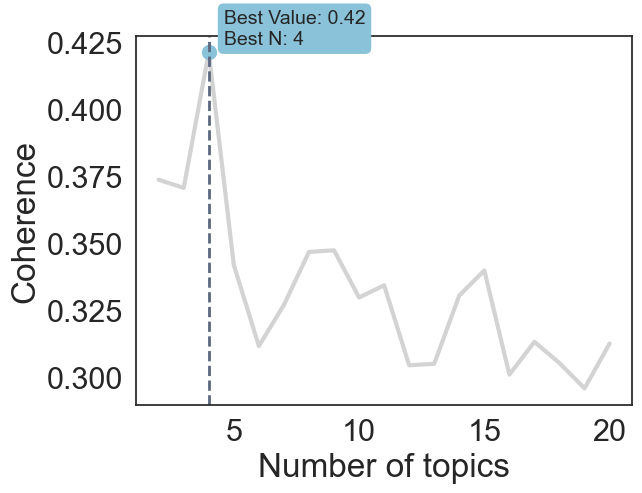

In [58]:
plot_coherence(start, limit, step, coherence_values_lda)

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
        Following we apply the intertopic distance map to evaluate the best model and the one with largest number of clusters.
    </p>
</div>

In [60]:
lda_display = pyLDAvis.gensim_models.prepare(model_list_lda[best_index_lda], corpus_tfidf, id2word, 
                                             sort_topics=False)
pyLDAvis.display(lda_display)

In [62]:
lda_display = pyLDAvis.gensim_models.prepare(model_list_lda[index_lda], corpus_tfidf, id2word, 
                                             sort_topics=False)
pyLDAvis.display(lda_display)

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    The code below creates two dataframes with the LDA classification for the best number of topics (<em>df_dominant_topic_best</em>) and the larger one (<em>df_dominant_topic_large</em>).
    </p>
</div>

In [64]:
df_dominant_topic_large_lda = format_topics_sentences(model_list_lda[index_lda], corpus_tfidf, list(data.full_text), 
                                            lemma_text, topic_dict=topic_dict)
df_dominant_topic_best_lda = format_topics_sentences(model_list_lda[best_index_lda], corpus_tfidf, list(data.full_text), lemma_text, topic_dict=topic_dict)
df_dominant_topic_best_lda.head()

,Text,Topic,Len,Lemma_text
0,"de Manuel de Sousa Baptista ao rei [D. José], ...",Topic 4,46,provisão dispensar ordenança obrigar compeler ...
1,do soldado da Brigada Real da Marinha da 1ª Co...,Topic 2,75,soldado brigada procurador príncipe regente li...
2,(traslado) das fazendas recebidas pelo capitão...,Topic 3,34,traslar capitão feitor impedimento capitão gama
3,passada pelo escrivão da câmara da cidade da R...,Topic 3,53,passado escrivão câmara ribeira posse ouvidor ...
4,do cabo de esquadra do 1º Regimento de Linha d...,Topic 1,46,esquadra regimento linha providência solicitaç...


<div class="alert alert-block alert-info">
    <p style="font-size:1em">
        Next, for the best model, we create the word cloud for the texts in each topic. We also translate and display the result in English (note that this is an automatic translation and some of the words might not me the proper one for the context). 
    </p>
</div>

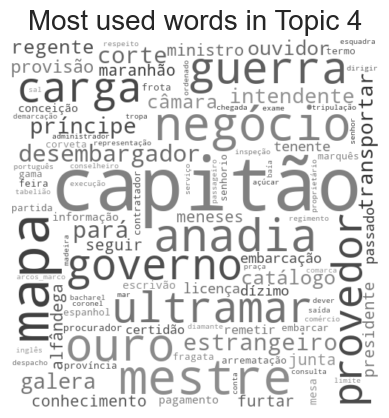

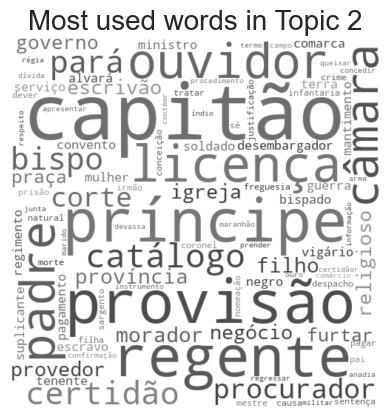

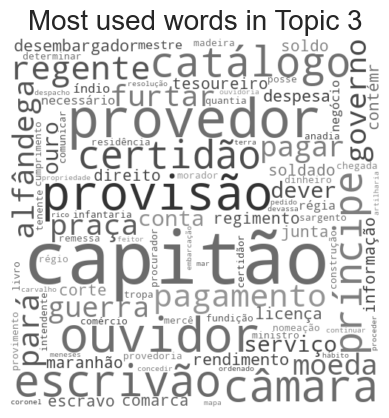

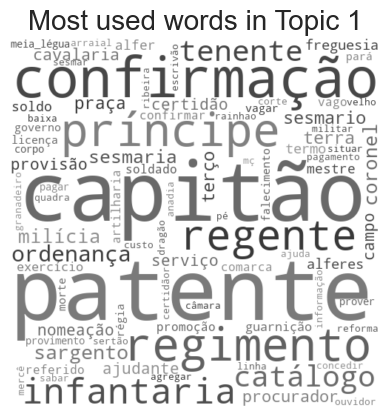

In [177]:
word_freq_topics_lda = df_to_dict(df_dominant_topic_best_lda)
show_wordcloud_dict(word_freq_topics_lda, prefix="LDA_all_pt")

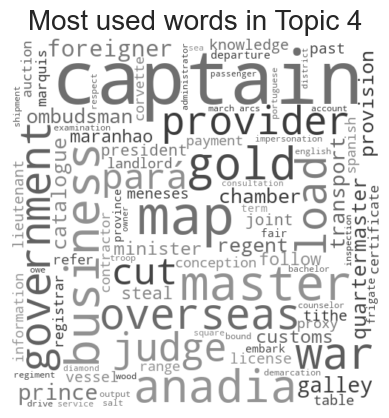

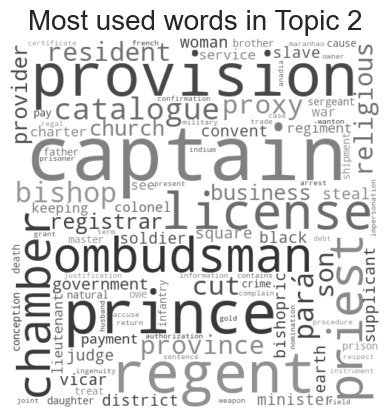

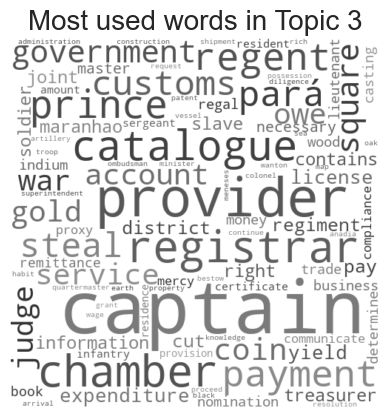

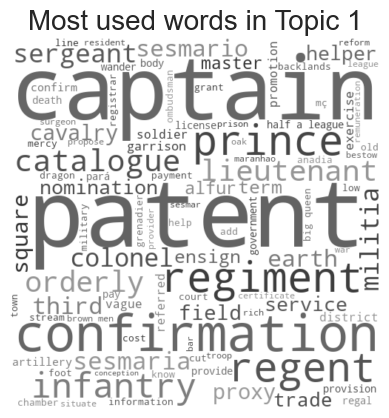

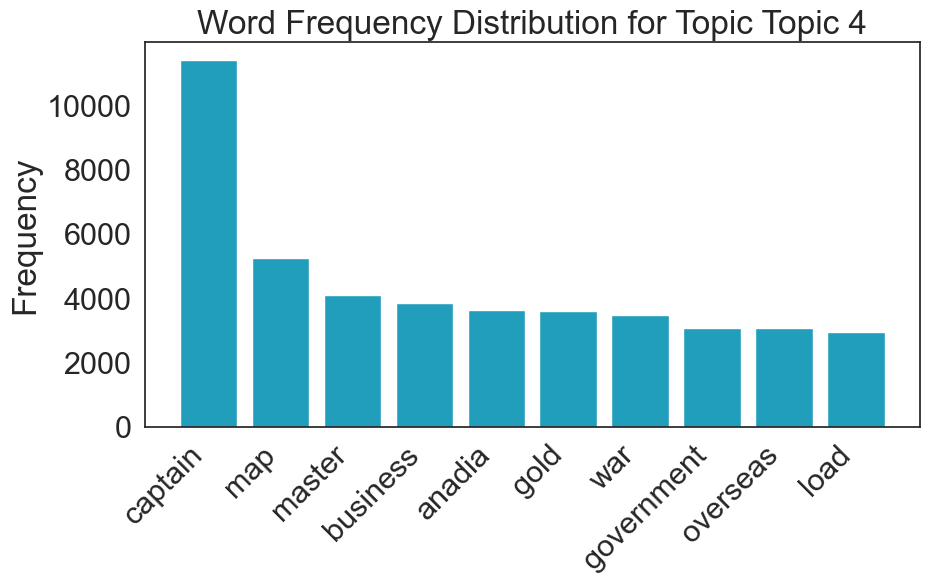

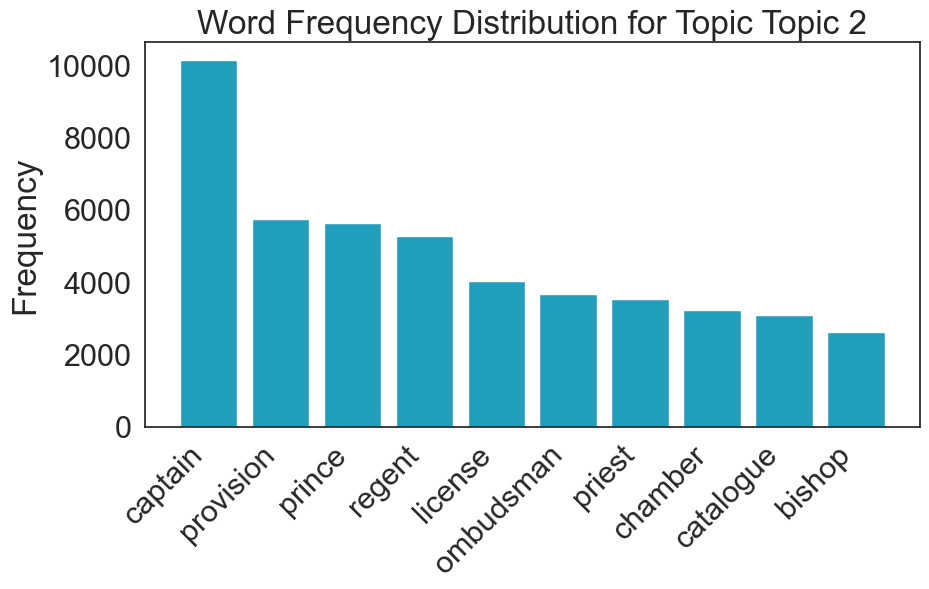

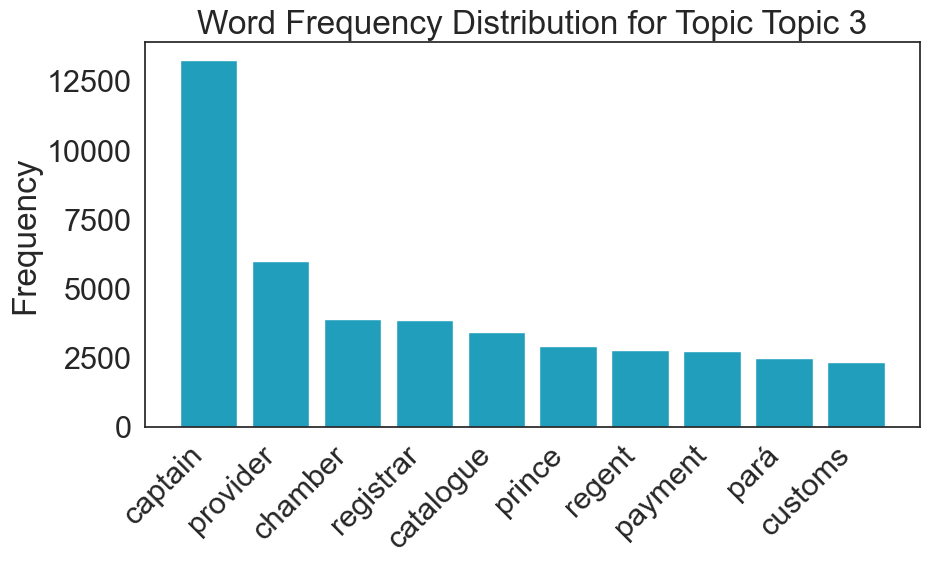

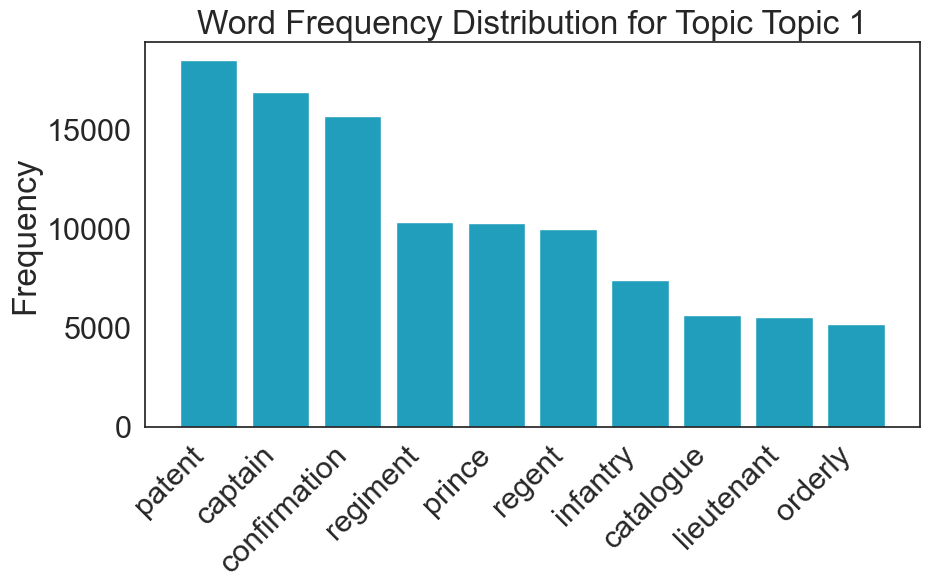

In [179]:
word_freq_topics_trans_lda = translate_topics(word_freq_topics_lda)
show_wordcloud_dict(word_freq_topics_trans_lda, prefix="LDA_all_en")
plot_word_frequency(word_freq_topics_trans_lda, prefix="lda", top_n=10)

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
The following two cell shows, for the model with the largest number of topics, word clouds for the texts in each topic. Again, we present the result in Portuguese and English. 
    </p>
</div>

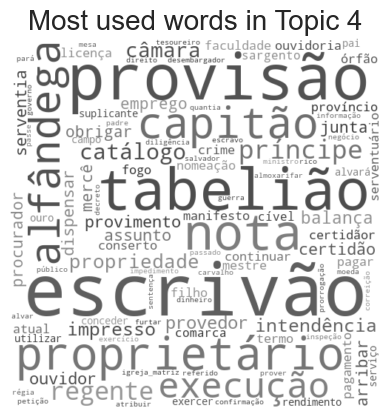

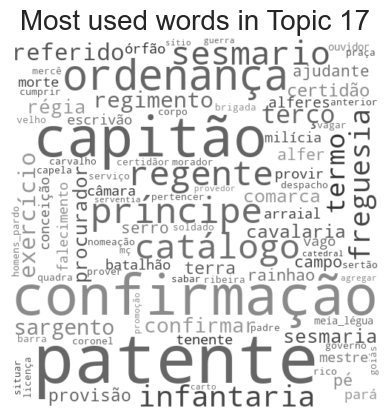

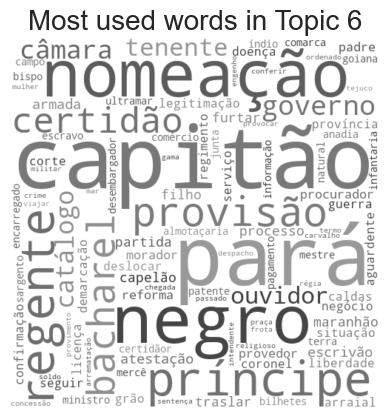

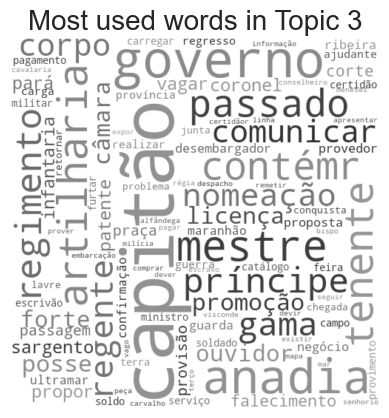

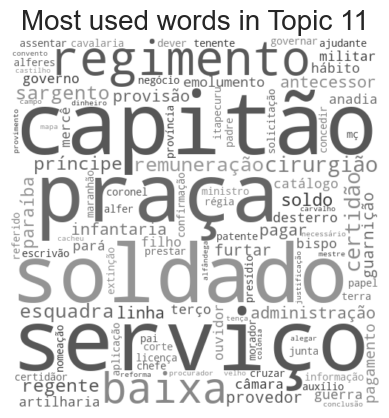

...

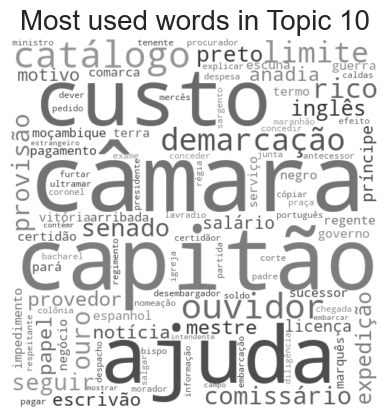

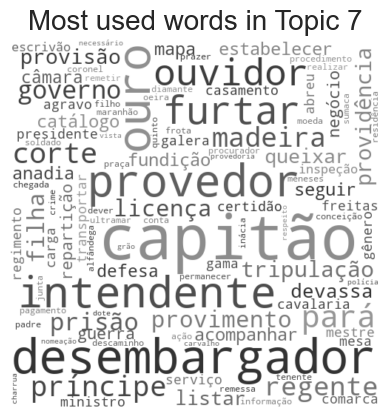

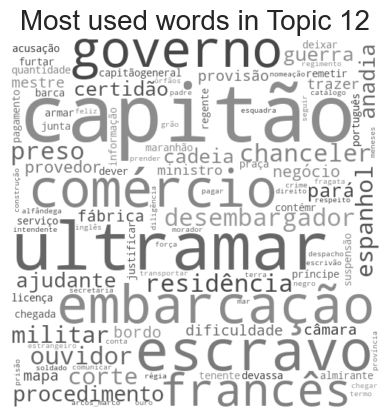

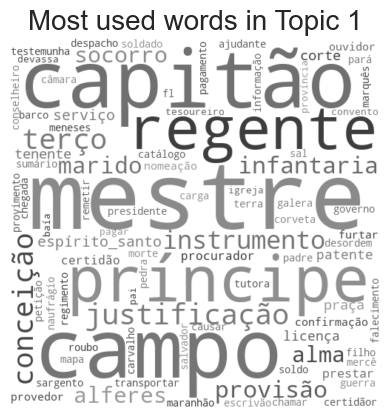

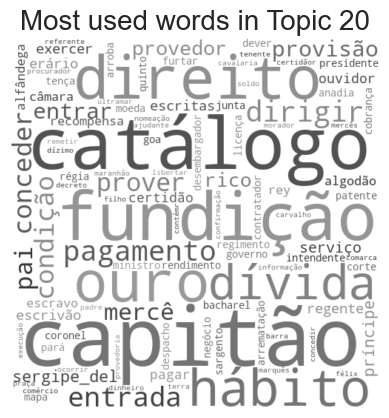

In [247]:
word_freq_topics_lda = df_to_dict(df_dominant_topic_large_lda)
show_wordcloud_dict(word_freq_topics_lda, prefix="LDA_all_2_pt")

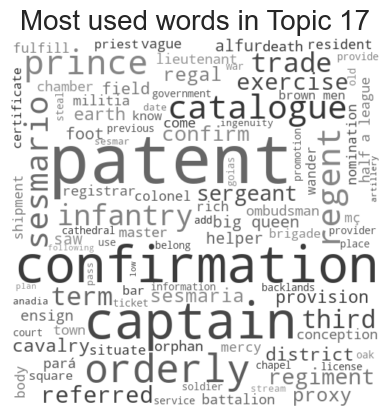

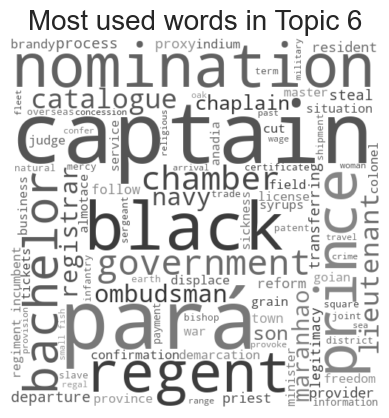

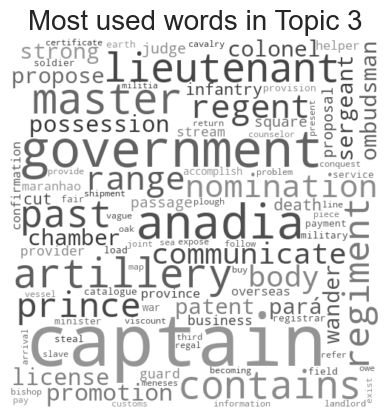

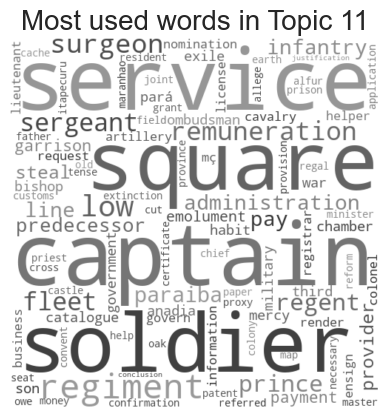

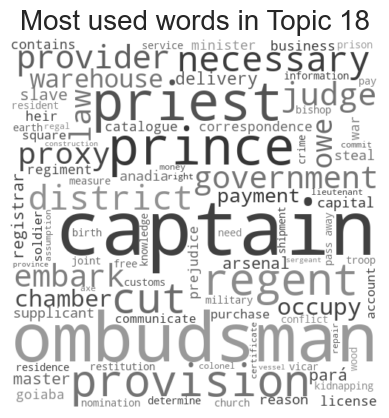

...

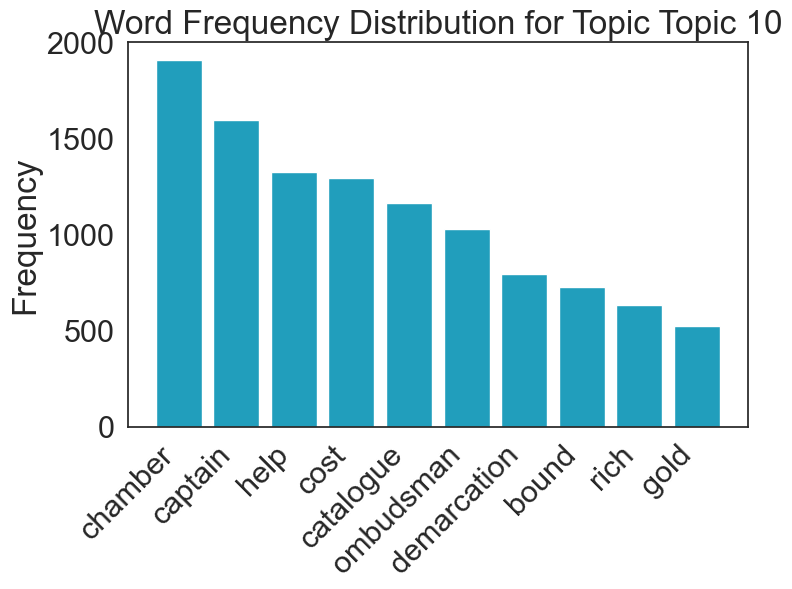

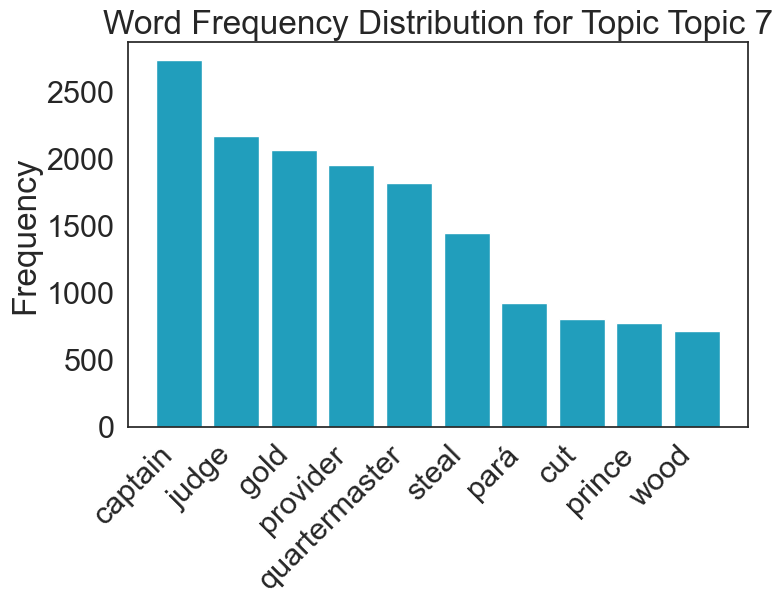

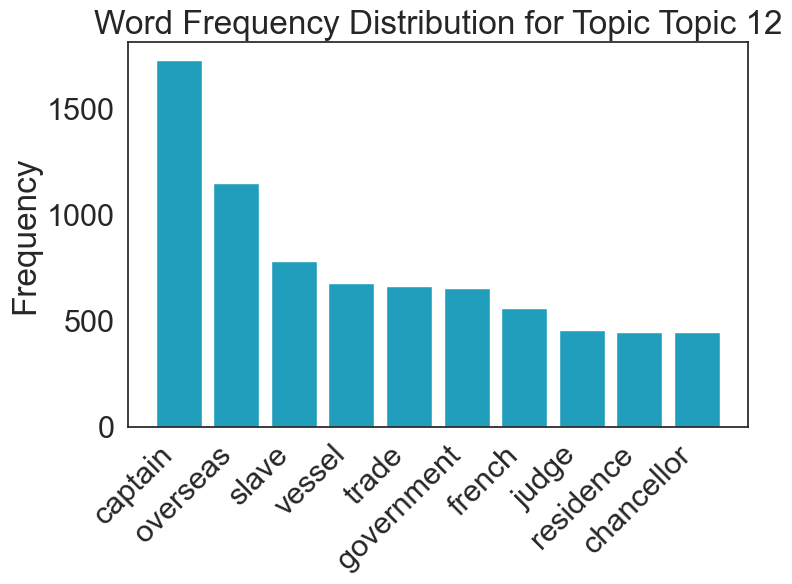

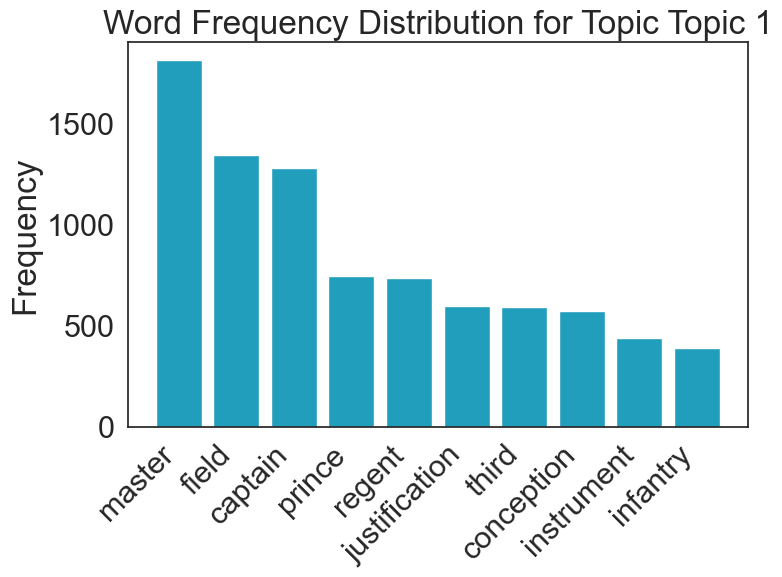

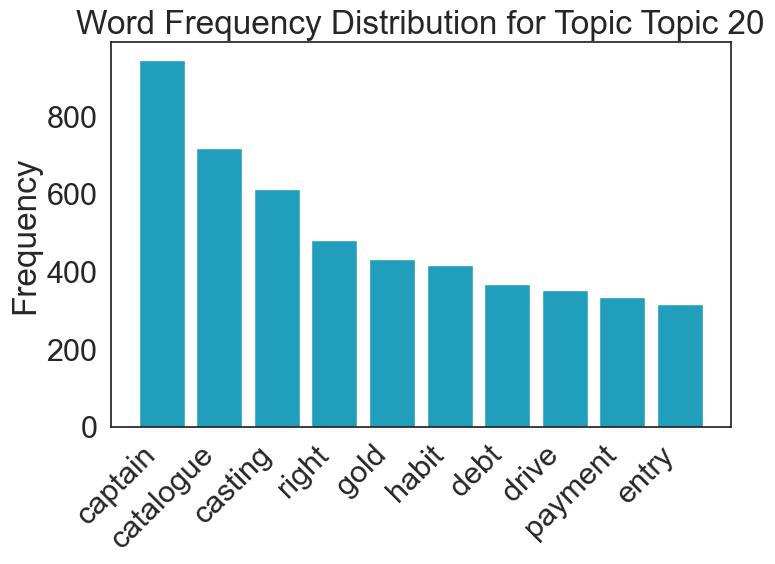

In [251]:
word_freq_topics_trans_lda = translate_topics(word_freq_topics_lda)
show_wordcloud_dict(word_freq_topics_trans_lda, prefix="LDA_all_2_en")
plot_word_frequency(word_freq_topics_trans_lda, prefix="lda_eng", top_n=10)

<div class="alert-block alert-success alert">
    <p style="font-size:medium">
    <b>Part 4:</b> LSI model.
    </p>
</div>

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    Similarly to the LDA, the LSI is another approach to tackle topic modelling. This model was selected due to its capacity to deal with synonyms and polysemy during the clustering. The dataset below shows a few examples of words in the clusters detected.
    </p>
</div>

In [90]:
model_list_lsi, coherence_values_lsi = calc_coherence_values(dictionary=id2word, corpus=corpus_tfidf, texts=texts, 
                                                     gensim_model=LsiModel, start=start, limit=limit, step=step)
index_lsi, best_index_lsi = n_topics-2, coherence_values_lsi.index(max(coherence_values_lsi))
result_lsi = format_topics_sentences(model_list_lsi[index_lsi], corpus_tfidf, list(data.full_text), lemma_text, topic_dict=topic_dict)
result_lsi.head()

,Text,Topic,Len,Lemma_text
0,"de Manuel de Sousa Baptista ao rei [D. José], ...",Topic 20,46.0,provisão dispensar ordenança obrigar compeler ...
1,do soldado da Brigada Real da Marinha da 1ª Co...,Topic 1,75.0,soldado brigada procurador príncipe regente li...
2,(traslado) das fazendas recebidas pelo capitão...,Topic 3,34.0,traslar capitão feitor impedimento capitão gama
3,passada pelo escrivão da câmara da cidade da R...,Topic 4,53.0,passado escrivão câmara ribeira posse ouvidor ...
4,do cabo de esquadra do 1º Regimento de Linha d...,Topic 20,46.0,esquadra regimento linha providência solicitaç...


<div class="alert alert-block alert-info">
    <p style="font-size:1em">
        The plot bellow display the coherence score for the LSI with different number of topics.
    </p>
</div>

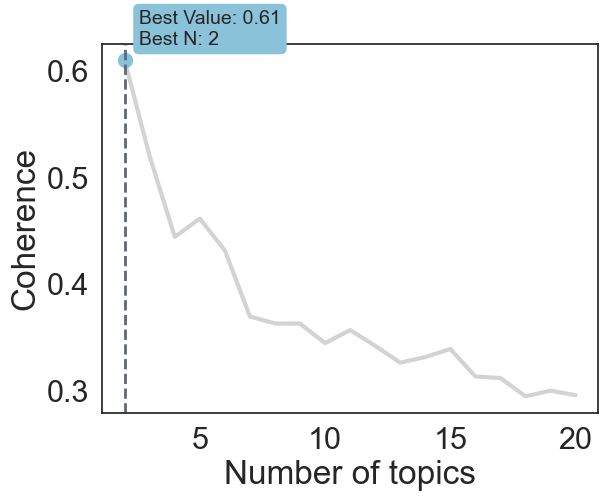

In [93]:
plot_coherence(start, limit, step, coherence_values_lsi)

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    The code below creates two dataframes with the LSI classification for the best number of topics (<em>df_dominant_topic_best</em>) and the larger one (<em>df_dominant_topic_large</em>).
    </p>
</div>

In [95]:
df_dominant_topic_large_lsi = format_topics_sentences(model_list_lsi[index_lsi], corpus_tfidf, list(data.full_text), 
                                            lemma_text, topic_dict=topic_dict)
df_dominant_topic_best_lsi = format_topics_sentences(model_list_lsi[best_index_lsi], corpus_tfidf, list(data.full_text), lemma_text, topic_dict=topic_dict)
df_dominant_topic_best_lsi.head()

,Text,Topic,Len,Lemma_text
0,"de Manuel de Sousa Baptista ao rei [D. José], ...",Topic 1,46.0,provisão dispensar ordenança obrigar compeler ...
1,do soldado da Brigada Real da Marinha da 1ª Co...,Topic 1,75.0,soldado brigada procurador príncipe regente li...
2,(traslado) das fazendas recebidas pelo capitão...,Topic 1,34.0,traslar capitão feitor impedimento capitão gama
3,passada pelo escrivão da câmara da cidade da R...,Topic 1,53.0,passado escrivão câmara ribeira posse ouvidor ...
4,do cabo de esquadra do 1º Regimento de Linha d...,Topic 1,46.0,esquadra regimento linha providência solicitaç...


<div class="alert alert-block alert-info">
    <p style="font-size:1em">
        Next, for the best model, we create the word cloud for the texts in each topic. We also translate and display the result in English (note that this is an automatic translation and some of the words might not me the proper one for the context). 
    </p>
</div>

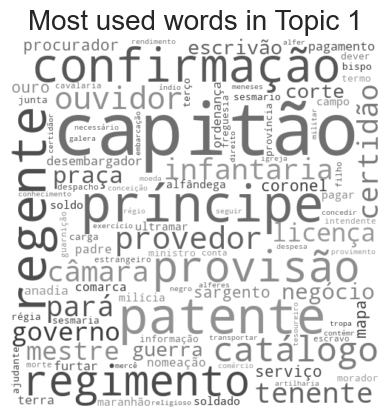

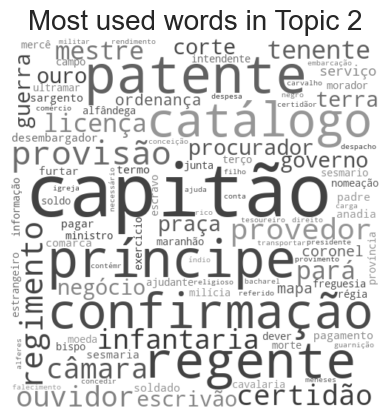

In [182]:
word_freq_topics_lsi = df_to_dict(df_dominant_topic_best_lsi)
show_wordcloud_dict(word_freq_topics_lsi, prefix="LSI_all_pt")

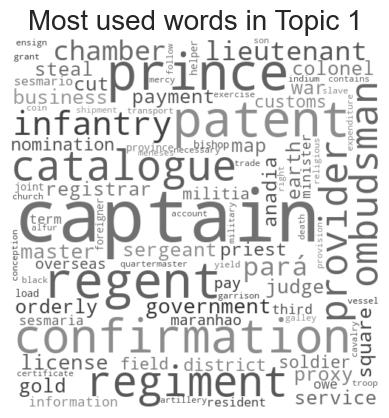

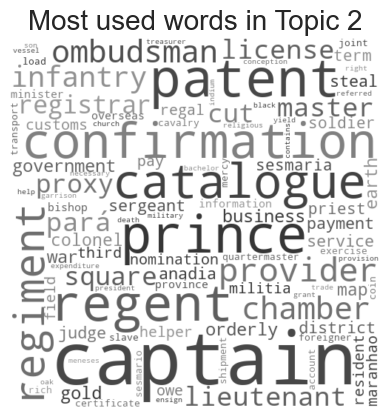

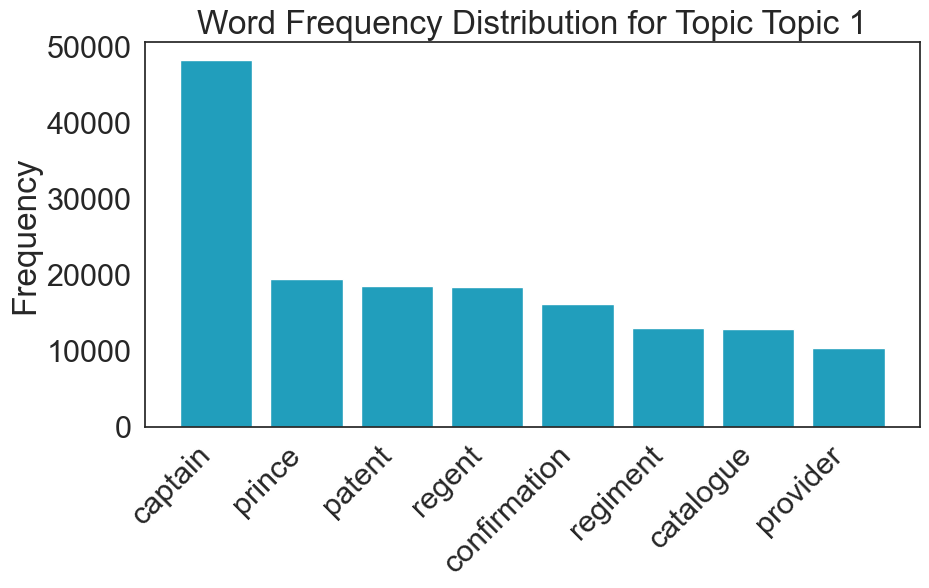

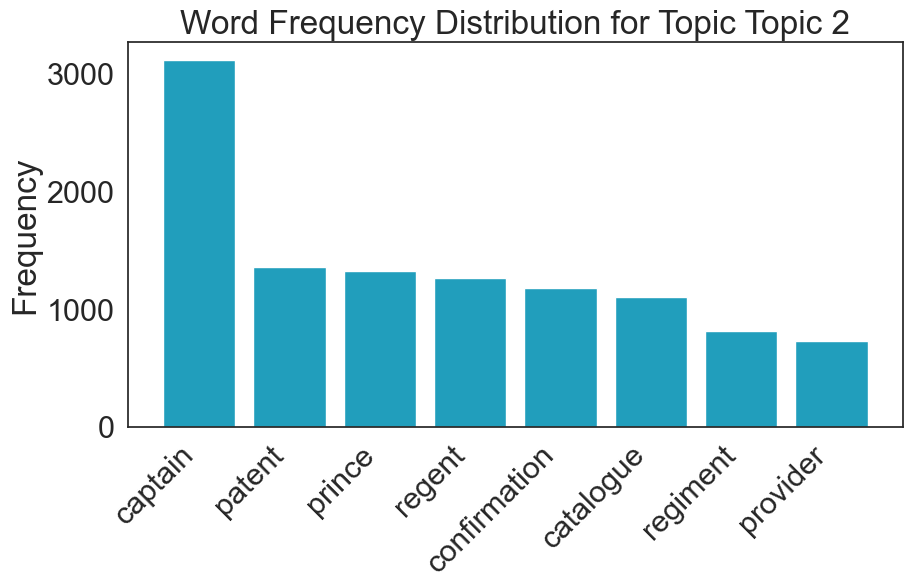

In [183]:
word_freq_topics_trans_lsi = translate_topics(word_freq_topics_lsi)
show_wordcloud_dict(word_freq_topics_trans_lsi, prefix="LSI_all_en")
plot_word_frequency(word_freq_topics_trans_lsi, prefix="lsi", top_n=8)

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
The following two cell shows, for the model with the largest number of topics, word clouds for the texts in each topic. Again, we present the result in Portuguese and English. 
    </p>
</div>

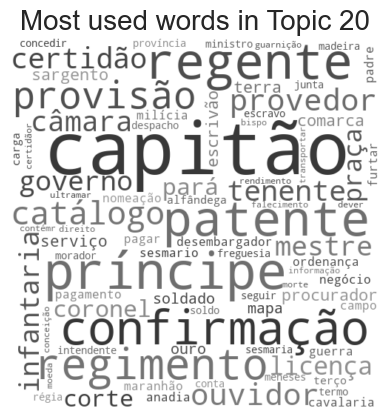

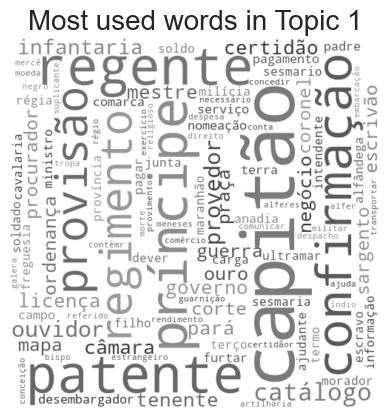

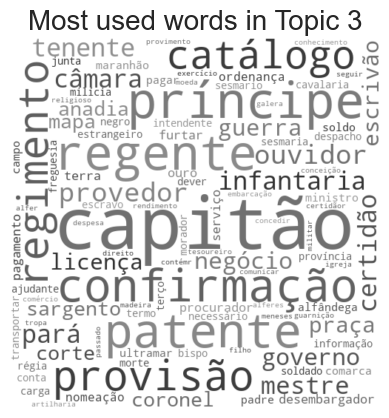

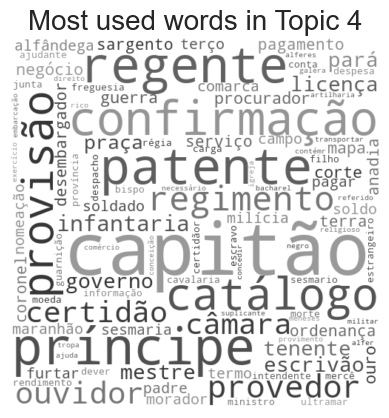

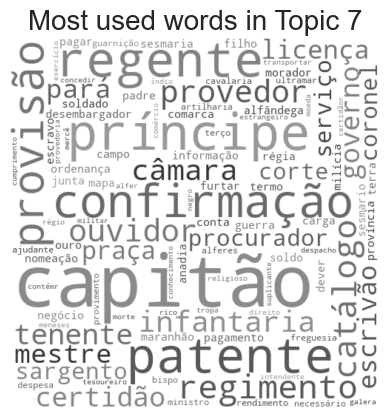

...

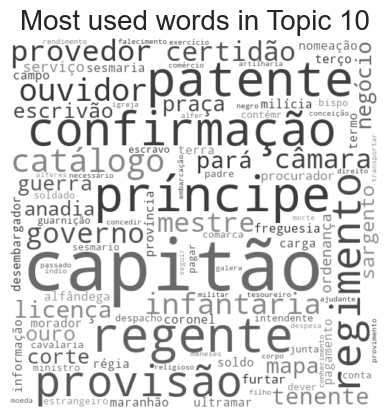

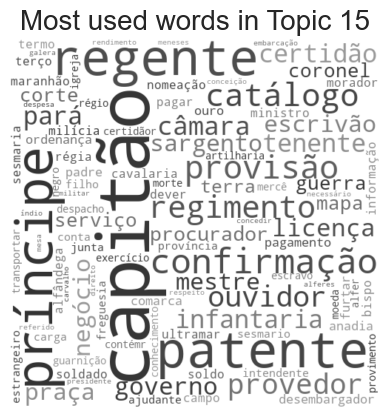

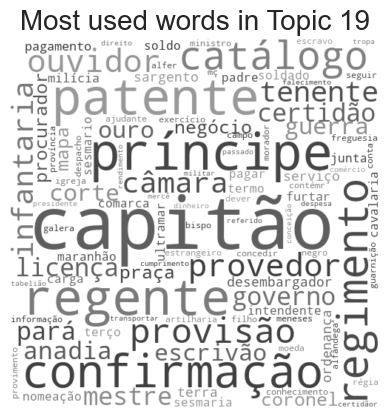

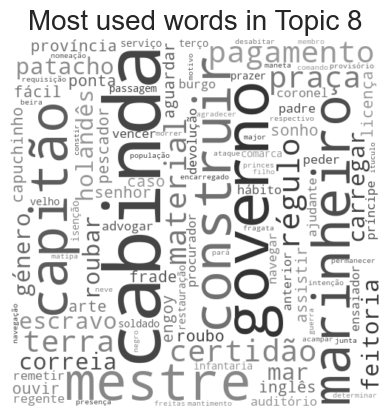

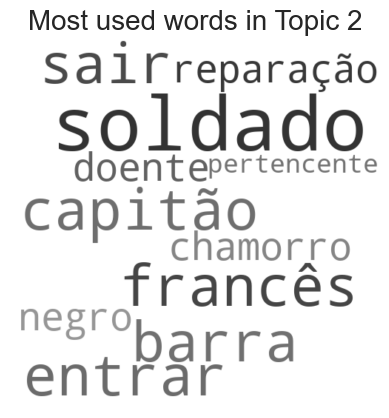

In [184]:
word_freq_topics_lsi = df_to_dict(df_dominant_topic_large_lsi)
show_wordcloud_dict(word_freq_topics_lsi, prefix="LSI_all_2_pt")

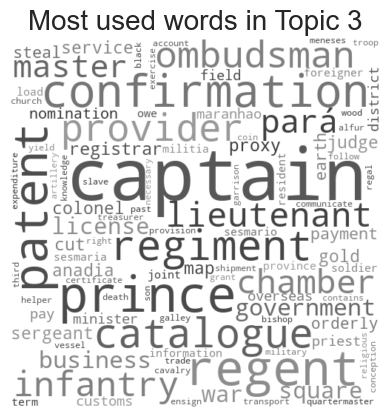

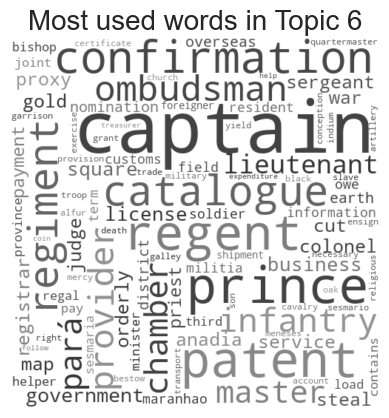

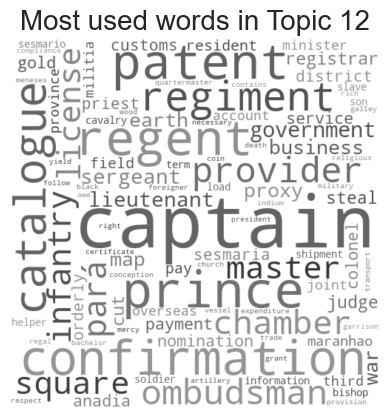

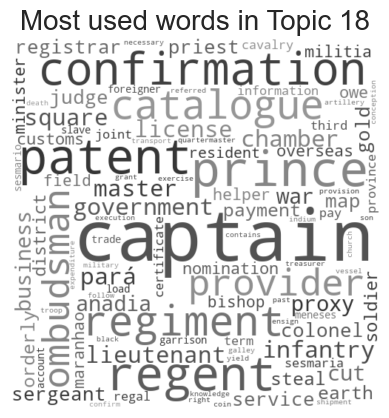

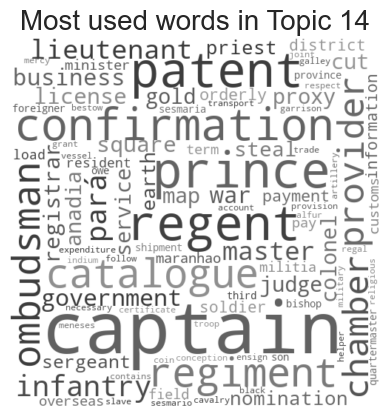

...

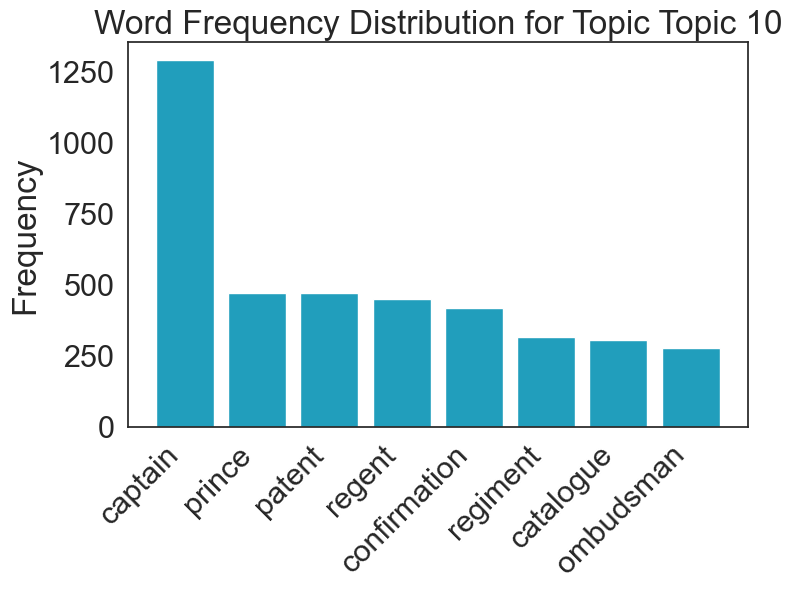

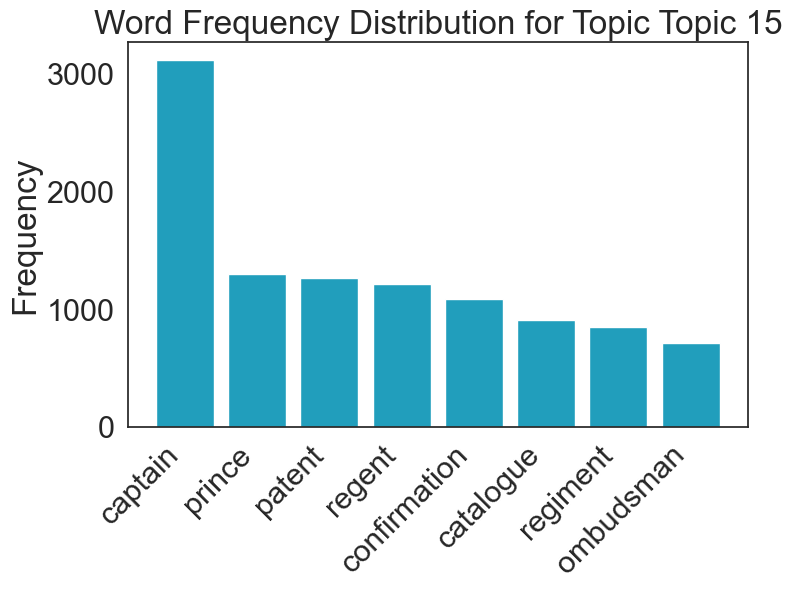

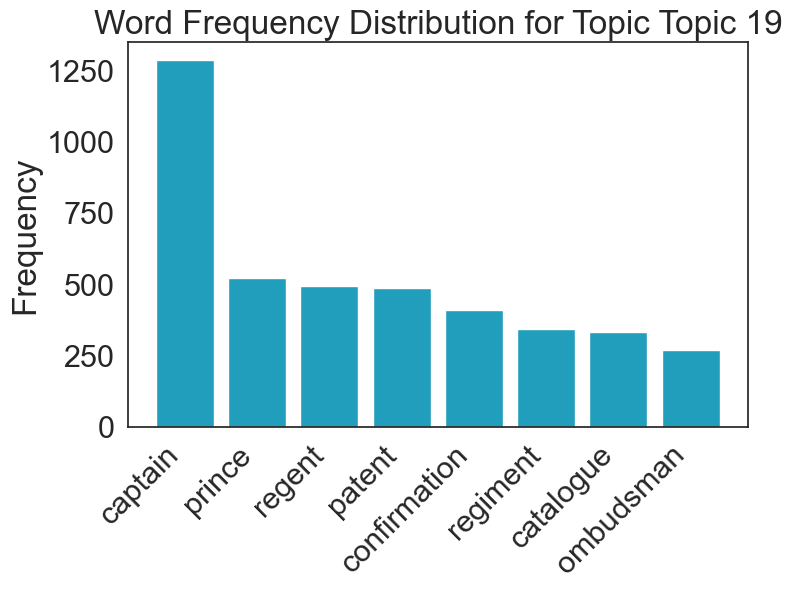

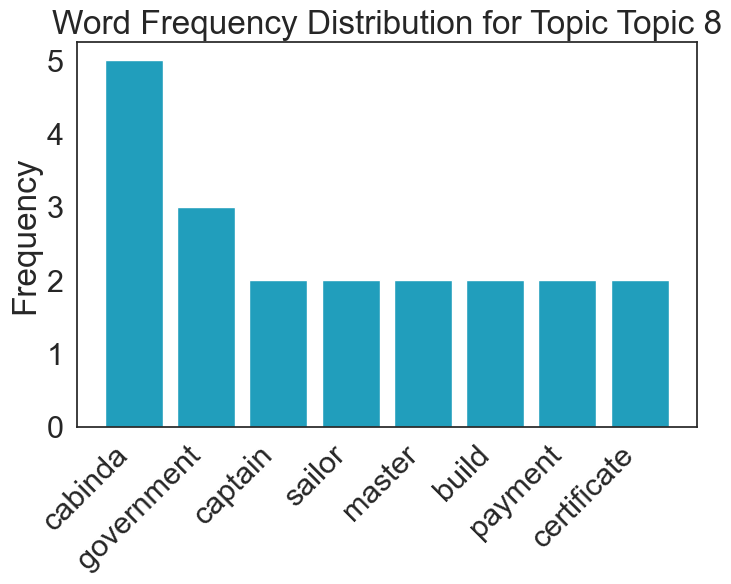

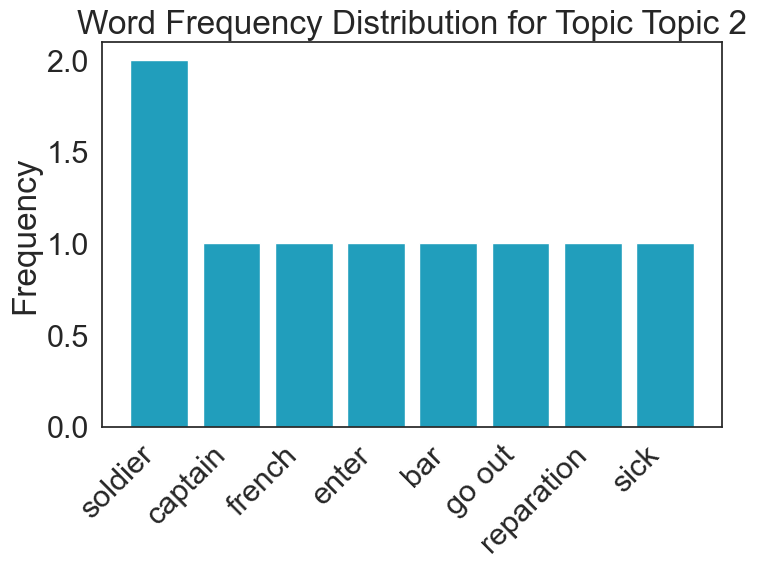

In [253]:
word_freq_topics_trans_lsi = translate_topics(word_freq_topics_lsi)
show_wordcloud_dict(word_freq_topics_trans_lsi, prefix="LSI_all_2_en")
plot_word_frequency(word_freq_topics_trans_lsi, prefix="lsi_eng", top_n=8)

<div class="alert-block alert-success alert">
    <p style="font-size:medium">
    <b>Part 5:</b> GSDMM model.
    </p>
</div>

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    Lastly, we present the results for the GSDMM model. Unlike previous methods, the GSDMM was designed to work with short-text documents. This model achieved better results than the LDA and LSI. The dataset below shows a few examples of words in the clusters detected.
    </p>
</div>

In [216]:
model_list_gsdmm, coherence_values_gsdmm = calc_coherence_values_gsdmm(dictionary=id2word, corpus=corpus_tfidf, texts=texts,
                                                           lemma_text=lemma_text, start=start, limit=limit, step=step)
index_gsdmm, best_index_gsdmm = n_topics-2, coherence_values_gsdmm.index(max(coherence_values_gsdmm))

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    The code below creates two dataframes with the GSDMM classification for the best number of topics (<em>df_dominant_topic_best</em>) and the larger one (<em>df_dominant_topic_large</em>).
    </p>
</div>

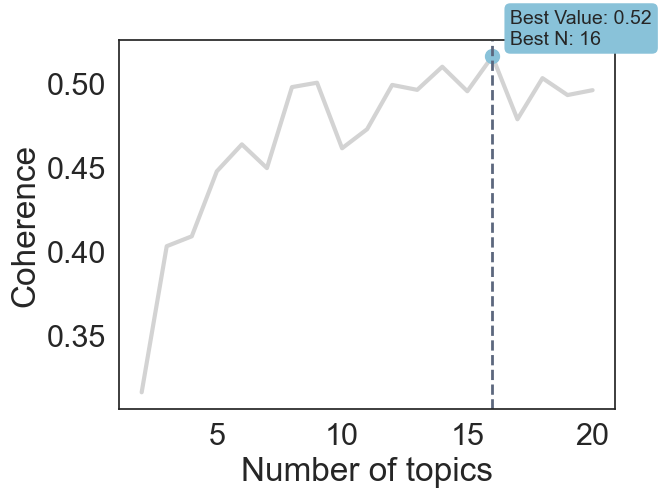

In [218]:
plot_coherence(start, limit, step, coherence_values_gsdmm)

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
    The code below creates two dataframes with the GSDMM classification for the best number of topics (<em>df_dominant_topic_best</em>) and the larger one (<em>df_dominant_topic_large</em>).
    </p>
</div>

In [229]:
# mgp, model = train_gsdmm(n_topics, lemma_text)
df_dominant_topic_large_gsdmm = create_topics_dataframe_gsdmm(data=data, mgp=model_list_gsdmm[index_gsdmm], threshold=0.3, topic_dict=topic_dict)
df_dominant_topic_best_gsdmm = create_topics_dataframe_gsdmm(data=data, mgp=model_list_gsdmm[best_index_gsdmm], threshold=0.3, topic_dict=topic_dict)
df_dominant_topic_best_gsdmm.head()

,id_document,Text,Topic,Len,Lemma_text,Source_file
0,164421,"de Manuel de Sousa Baptista ao rei [D. José], ...",Topic 4,272,provisão dispensar ordenança obrigar compeler ...,CU-Bahia.pdf
1,281830,do soldado da Brigada Real da Marinha da 1ª Co...,Topic 4,414,soldado brigada procurador príncipe regente li...,CU-RioJaneiro.pdf
2,195142,(traslado) das fazendas recebidas pelo capitão...,Other,220,traslar capitão feitor impedimento capitão gama,CU-Guine-Parcial.pdf
3,188871,passada pelo escrivão da câmara da cidade da R...,Topic 16,308,passado escrivão câmara ribeira posse ouvidor ...,CU-CaboVerde-Parcial.pdf
4,168427,do cabo de esquadra do 1º Regimento de Linha d...,Topic 4,287,esquadra regimento linha providência solicitaç...,CU-Bahia.pdf


<div class="alert alert-block alert-info">
    <p style="font-size:1em">
        Next, for the best model, we create the word cloud for the texts in each topic. We also translate and display the result in English (note that this is an automatic translation and some of the words might not me the proper one for the context). 
    </p>
</div>

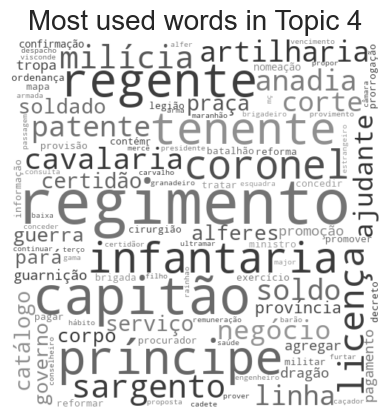

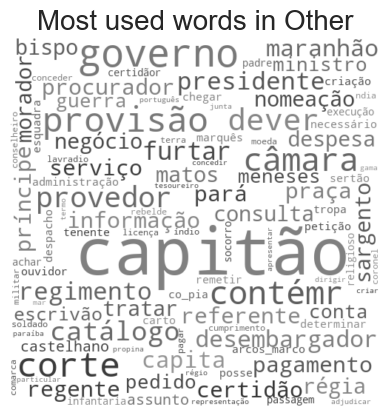

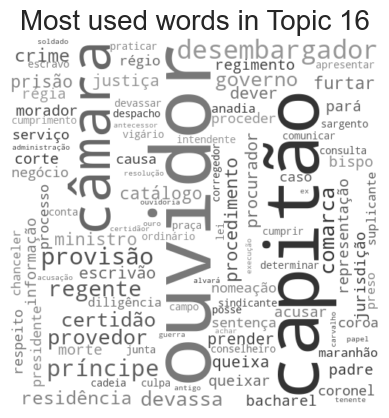

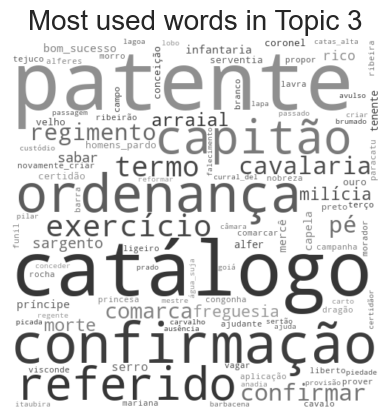

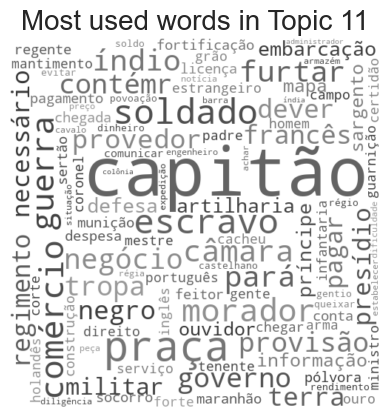

...

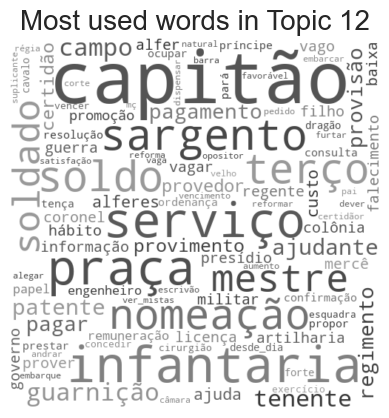

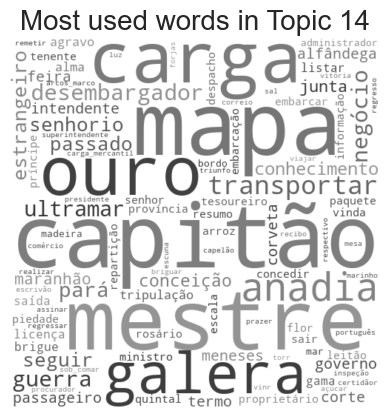

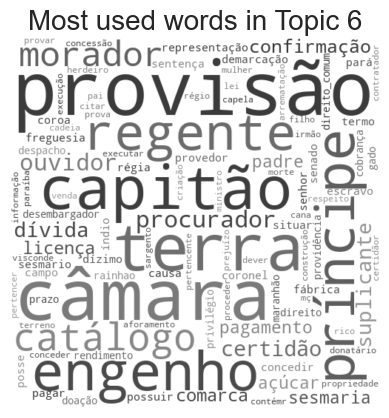

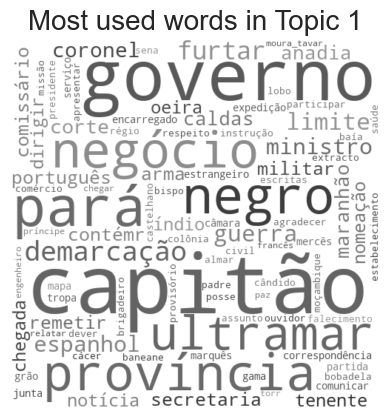

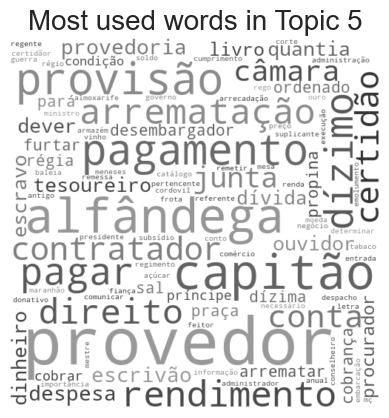

In [231]:
word_freq_topics_gsdmm = df_to_dict(df_dominant_topic_best_gsdmm)
show_wordcloud_dict(word_freq_topics_gsdmm, prefix="GSDMM_all_pt")

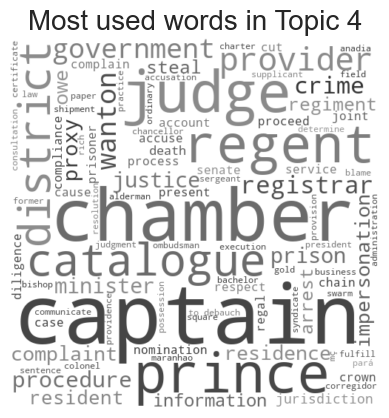

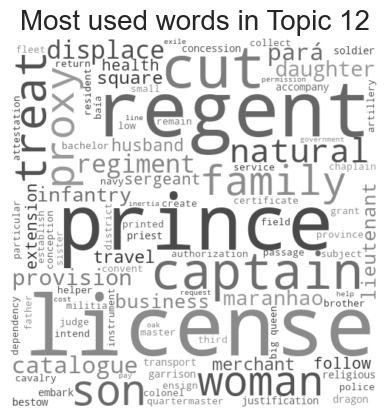

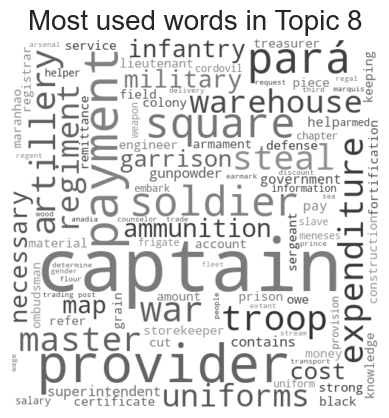

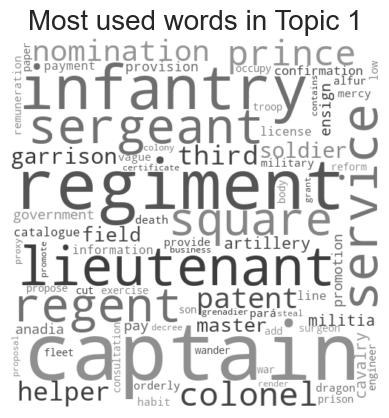

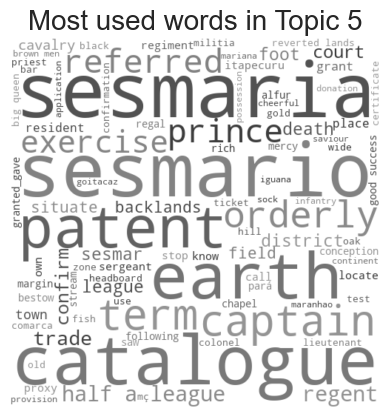

...

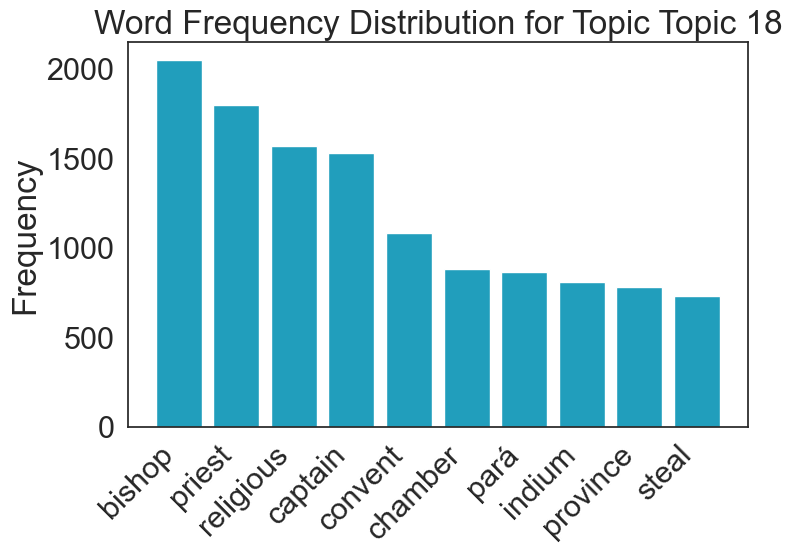

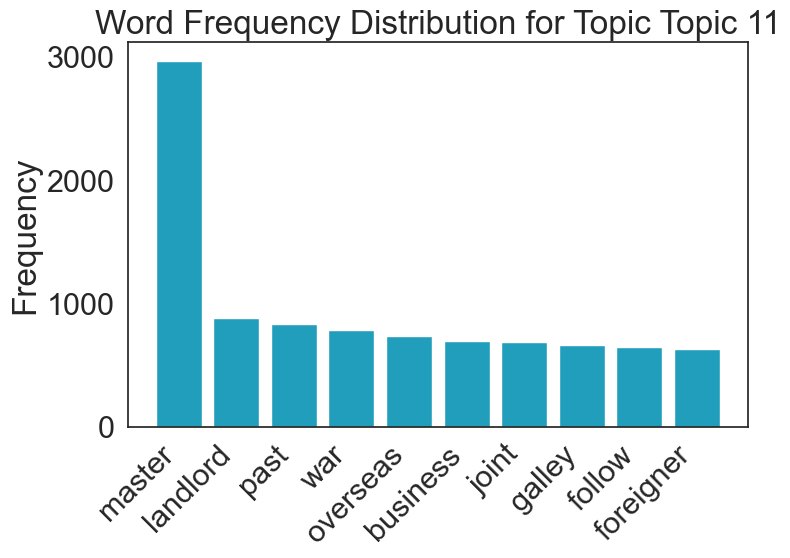

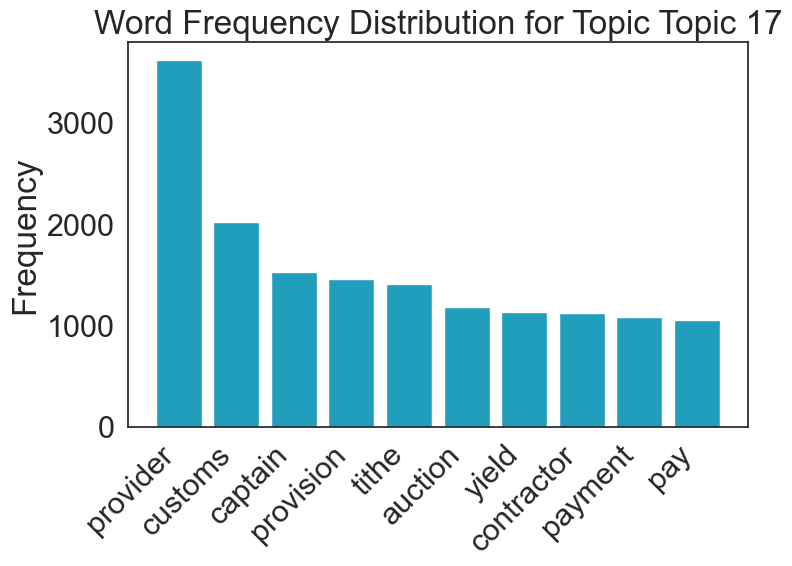

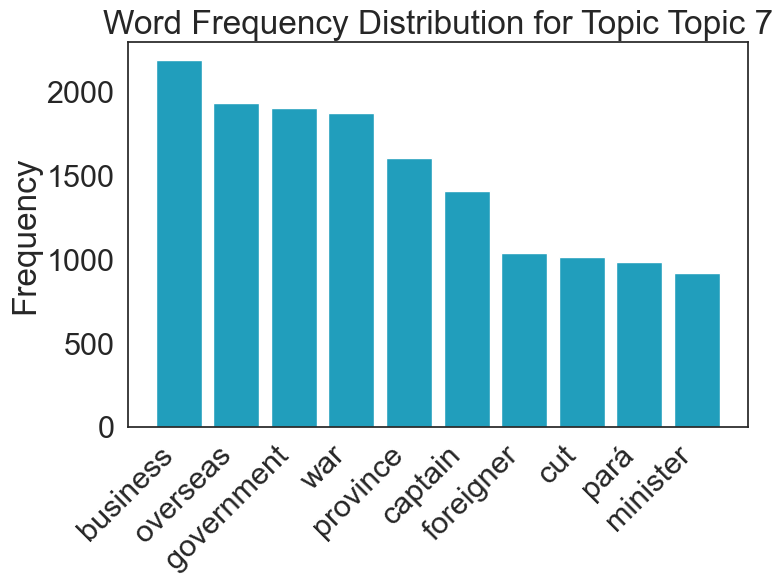

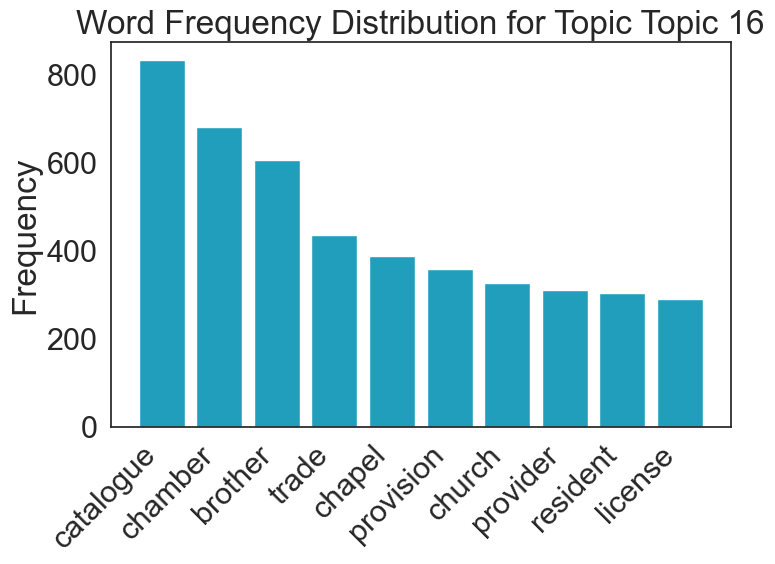

In [255]:
word_freq_topics_trans_gsdmm = translate_topics(word_freq_topics_gsdmm)
show_wordcloud_dict(word_freq_topics_trans_gsdmm, prefix="GSDMM_all_en")
plot_word_frequency(word_freq_topics_trans_gsdmm, prefix="gsdmm", top_n=10)

<div class="alert alert-block alert-info">
    <p style="font-size:1em">
The following two cell shows, for the model with the largest number of topics, word clouds for the texts in each topic. Again, we present the result in Portuguese and English. 
    </p>
</div>

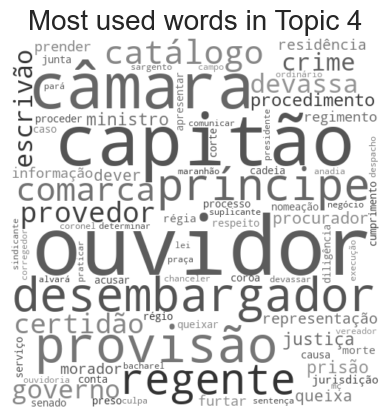

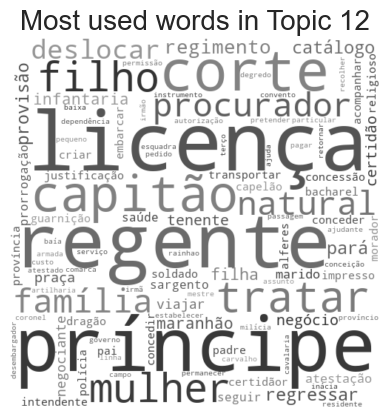

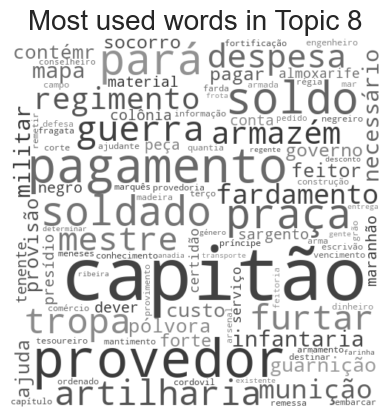

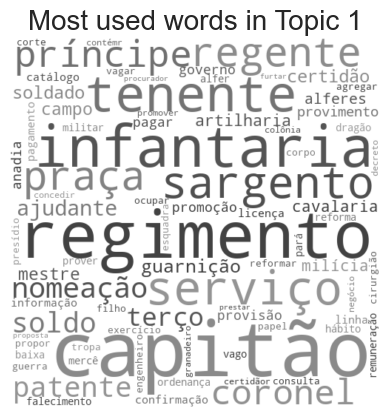

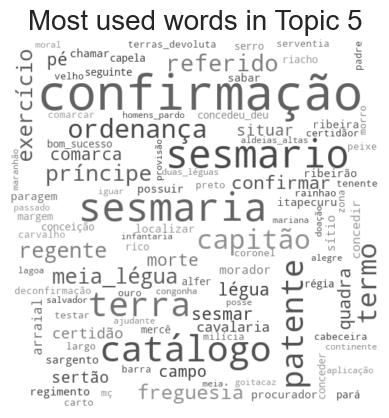

...

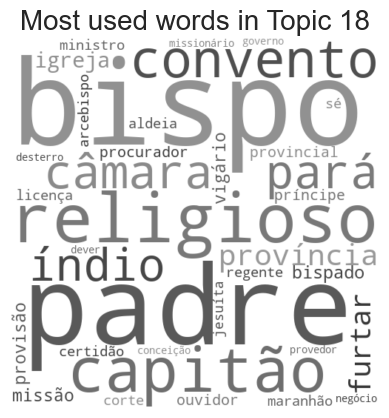

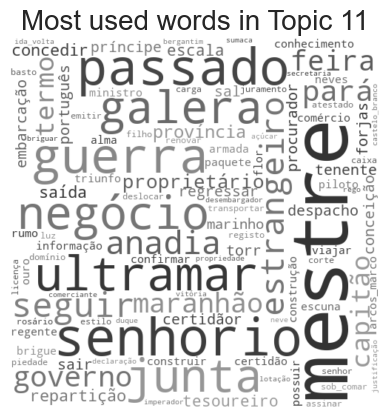

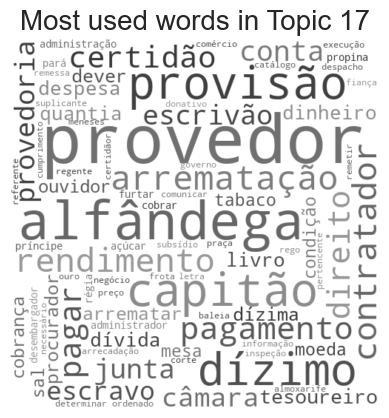

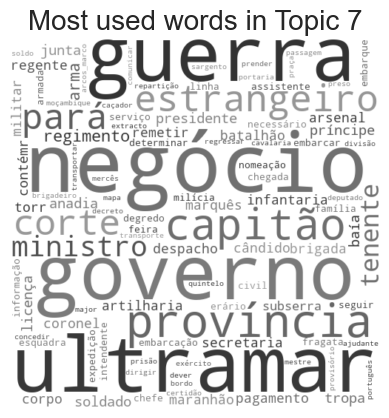

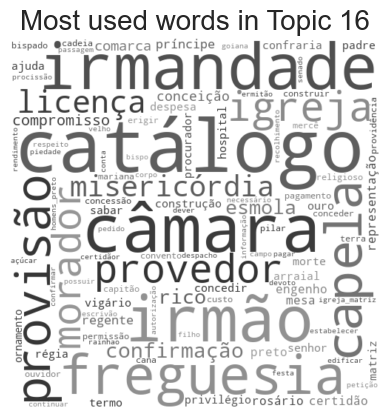

In [234]:
word_freq_topics_gsdmm = df_to_dict(df_dominant_topic_large_gsdmm)
show_wordcloud_dict(word_freq_topics_gsdmm, prefix="GSDMM_all_2_pt")

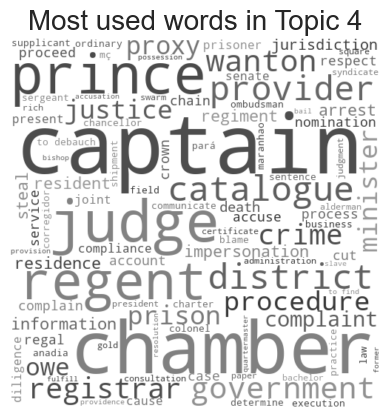

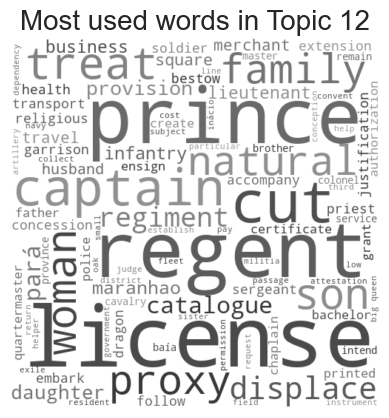

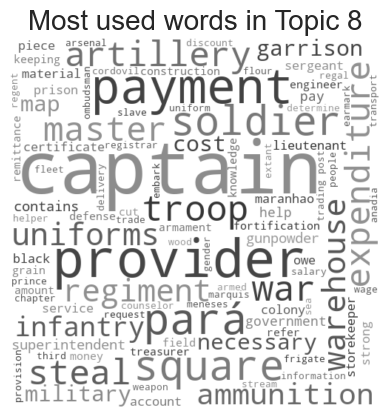

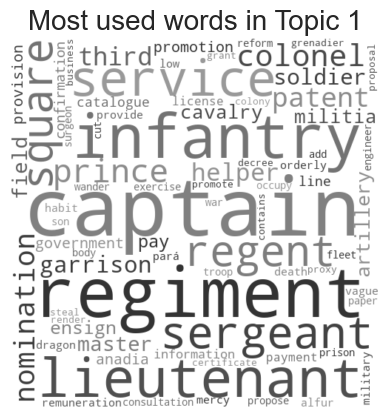

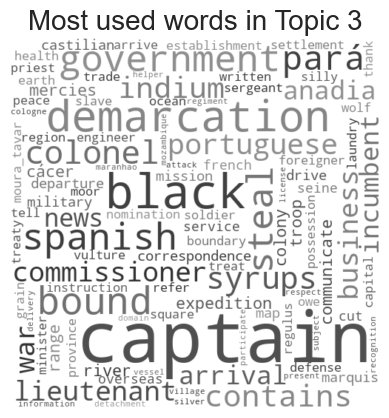

...

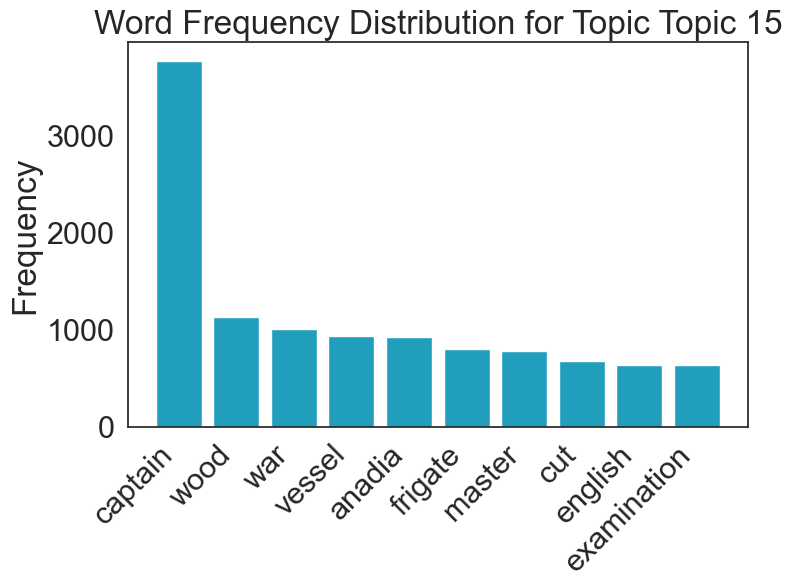

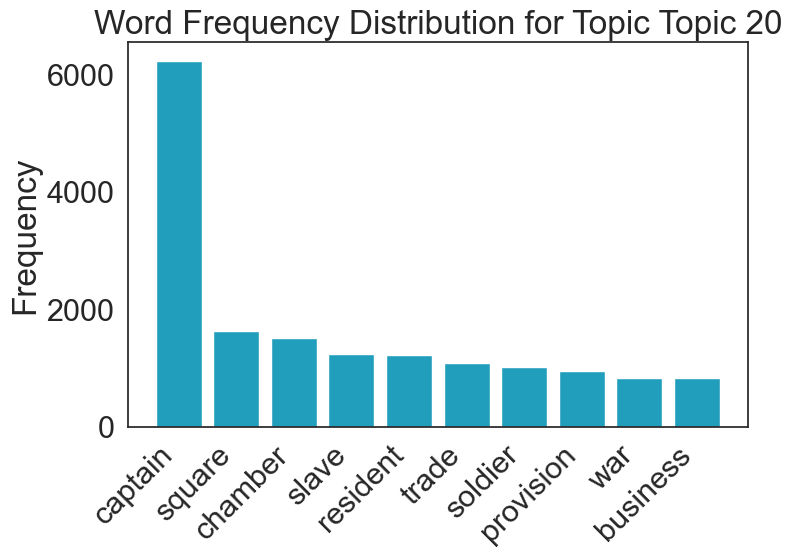

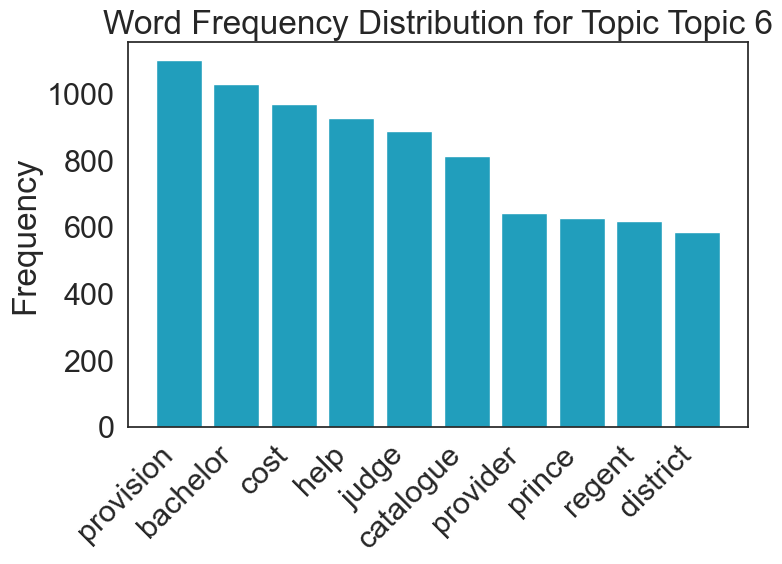

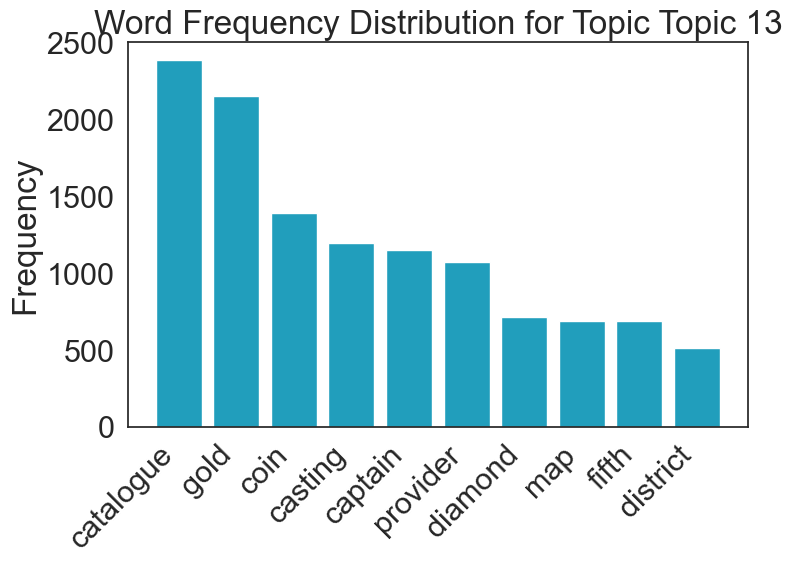

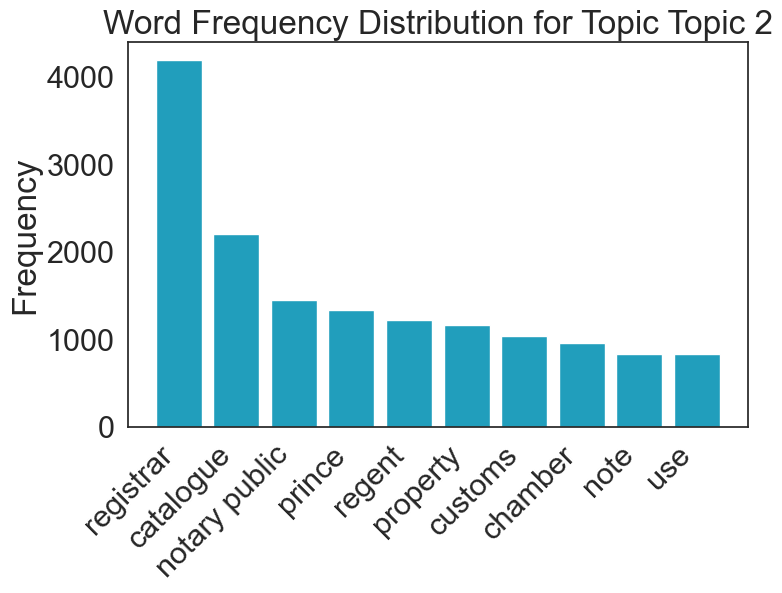

In [257]:
word_freq_topics_trans_gsdmm = translate_topics(word_freq_topics_gsdmm)
show_wordcloud_dict(word_freq_topics_trans_gsdmm, prefix="GSDMM_all_2_en")
plot_word_frequency(word_freq_topics_trans_gsdmm, prefix="gsdmm_eng", top_n=10)